In [1]:
import datetime
from pystac_client import Client
import pystac
import rioxarray
import rasterio as rio
import numpy as np
from shapely.geometry import shape, mapping
import geopandas as gpd
from pyproj import CRS
from PIL import Image
import matplotlib.pyplot as plt
from pyproj import Transformer

In [2]:
api_url = "https://earth-search.aws.element84.com/v1"

In [3]:
client = Client.open(api_url)

In [4]:
client

<Client id=earth-search-aws>

In [5]:
collection = "sentinel-2-l2a"

In [6]:
def load_farm_polygon(geojson_path):
    gdf = gpd.read_file(geojson_path)
    return gdf.geometry.values[0]


In [7]:
geojson_path = '/home/nandanaa/Downloads/client/farm_p.geojson'
farm_polygon = load_farm_polygon(geojson_path)

geometry = mapping(farm_polygon)


In [8]:
geometry

{'type': 'MultiPolygon',
 'coordinates': [(((-57.772978250070615, 6.495230134858337),
    (-57.7679849909013, 6.493470481757058),
    (-57.767933045422296, 6.491567978588515),
    (-57.77304318191937, 6.493321138504919),
    (-57.77304318191937, 6.493334124874671),
    (-57.772978250070615, 6.495230134858337)),)]}

In [9]:
gdf = gpd.read_file(geojson_path)
bbox = gdf.geometry[0].bounds

In [10]:
bbox

(-57.77304318191937, 6.491567978588515, -57.767933045422296, 6.495230134858337)

In [11]:
search = client.search(
    collections=[collection],
    bbox=bbox,
    datetime="2024-01-01/2024-08-05",
    query=["eo:cloud_cover<50"]
)
print(search.matched())

39


In [12]:
items = search.item_collection()
items.save_object("search.json")

In [13]:
items

In [14]:
for item in items:
    print(item)

<Item id=S2A_21NVH_20240804_0_L2A>
<Item id=S2A_21NVH_20240725_0_L2A>
<Item id=S2B_21NVH_20240720_0_L2A>
<Item id=S2A_21NVH_20240715_0_L2A>
<Item id=S2B_21NVH_20240710_0_L2A>
<Item id=S2A_21NVH_20240705_0_L2A>
<Item id=S2A_21NVH_20240625_0_L2A>
<Item id=S2B_21NVH_20240620_0_L2A>
<Item id=S2B_21NVH_20240610_0_L2A>
<Item id=S2A_21NVH_20240605_0_L2A>
<Item id=S2B_21NVH_20240531_0_L2A>
<Item id=S2A_21NVH_20240526_0_L2A>
<Item id=S2B_21NVH_20240521_0_L2A>
<Item id=S2A_21NVH_20240516_0_L2A>
<Item id=S2B_21NVH_20240511_0_L2A>
<Item id=S2A_21NVH_20240506_0_L2A>
<Item id=S2B_21NVH_20240501_0_L2A>
<Item id=S2A_21NVH_20240426_0_L2A>
<Item id=S2B_21NVH_20240421_0_L2A>
<Item id=S2B_21NVH_20240411_0_L2A>
<Item id=S2A_21NVH_20240406_0_L2A>
<Item id=S2B_21NVH_20240401_0_L2A>
<Item id=S2A_21NVH_20240327_0_L2A>
<Item id=S2A_21NVH_20240317_0_L2A>
<Item id=S2B_21NVH_20240312_0_L2A>
<Item id=S2A_21NVH_20240307_0_L2A>
<Item id=S2B_21NVH_20240302_1_L2A>
<Item id=S2A_21NVH_20240226_0_L2A>
<Item id=S2B_21NVH_2

In [15]:
for item in items:
    print(item.datetime)
    print(item.geometry)
    print(item.properties)
    

2024-08-04 14:20:50.621000+00:00
{'type': 'Polygon', 'coordinates': [[[-57.900341785606216, 7.236928426642521], [-57.90610865507623, 7.211310736285508], [-57.90431726536382, 6.24380236311669], [-56.91177838818477, 6.244571752710915], [-56.911598622490736, 7.237809826458827], [-57.900341785606216, 7.236928426642521]]]}
{'created': '2024-08-04T21:37:00.298Z', 'platform': 'sentinel-2a', 'constellation': 'sentinel-2', 'instruments': ['msi'], 'eo:cloud_cover': 82.403767, 'proj:epsg': 32621, 'mgrs:utm_zone': 21, 'mgrs:latitude_band': 'N', 'mgrs:grid_square': 'VH', 'grid:code': 'MGRS-21NVH', 'view:sun_azimuth': 64.0008813483573, 'view:sun_elevation': 64.66562208764489, 's2:degraded_msi_data_percentage': 0.0353, 's2:nodata_pixel_percentage': 0.005385, 's2:saturated_defective_pixel_percentage': 0, 's2:cloud_shadow_percentage': 1.695759, 's2:vegetation_percentage': 0.079742, 's2:not_vegetated_percentage': 0.00649, 's2:water_percentage': 15.795904, 's2:unclassified_percentage': 0.018342, 's2:medi

In [16]:
assets = items[1].assets  
print(assets.keys())

dict_keys(['aot', 'blue', 'coastal', 'granule_metadata', 'green', 'nir', 'nir08', 'nir09', 'red', 'rededge1', 'rededge2', 'rededge3', 'scl', 'swir16', 'swir22', 'thumbnail', 'tileinfo_metadata', 'visual', 'wvp', 'aot-jp2', 'blue-jp2', 'coastal-jp2', 'green-jp2', 'nir-jp2', 'nir08-jp2', 'nir09-jp2', 'red-jp2', 'rededge1-jp2', 'rededge2-jp2', 'rededge3-jp2', 'scl-jp2', 'swir16-jp2', 'swir22-jp2', 'visual-jp2', 'wvp-jp2'])


In [17]:
for key, asset in assets.items():
    print(f"{key}: {asset.title}")

aot: Aerosol optical thickness (AOT)
blue: Blue (band 2) - 10m
coastal: Coastal aerosol (band 1) - 60m
granule_metadata: None
green: Green (band 3) - 10m
nir: NIR 1 (band 8) - 10m
nir08: NIR 2 (band 8A) - 20m
nir09: NIR 3 (band 9) - 60m
red: Red (band 4) - 10m
rededge1: Red edge 1 (band 5) - 20m
rededge2: Red edge 2 (band 6) - 20m
rededge3: Red edge 3 (band 7) - 20m
scl: Scene classification map (SCL)
swir16: SWIR 1 (band 11) - 20m
swir22: SWIR 2 (band 12) - 20m
thumbnail: Thumbnail image
tileinfo_metadata: None
visual: True color image
wvp: Water vapour (WVP)
aot-jp2: Aerosol optical thickness (AOT)
blue-jp2: Blue (band 2) - 10m
coastal-jp2: Coastal aerosol (band 1) - 60m
green-jp2: Green (band 3) - 10m
nir-jp2: NIR 1 (band 8) - 10m
nir08-jp2: NIR 2 (band 8A) - 20m
nir09-jp2: NIR 3 (band 9) - 60m
red-jp2: Red (band 4) - 10m
rededge1-jp2: Red edge 1 (band 5) - 20m
rededge2-jp2: Red edge 2 (band 6) - 20m
rededge3-jp2: Red edge 3 (band 7) - 20m
scl-jp2: Scene classification map (SCL)
swi

In [18]:
print(assets["thumbnail"].href)

https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/21/N/VH/2024/7/S2A_21NVH_20240725_0_L2A/thumbnail.jpg


In [19]:
nir_href = assets["nir"].href
nir = rioxarray.open_rasterio(nir_href)
print(nir)

<xarray.DataArray (band: 1, y: 10980, x: 10980)>
[120560400 values with dtype=uint16]
Coordinates:
  * band         (band) int64 1
  * x            (x) float64 4e+05 4e+05 4e+05 ... 5.097e+05 5.097e+05 5.098e+05
  * y            (y) float64 8e+05 8e+05 8e+05 ... 6.903e+05 6.903e+05 6.902e+05
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:       Area
    OVR_RESAMPLING_ALG:  AVERAGE
    _FillValue:          0
    scale_factor:        1.0
    add_offset:          0.0


In [20]:
import os
os.environ["GDAL_HTTP_COOKIEFILE"] = "./cookies.txt"
os.environ["GDAL_HTTP_COOKIEJAR"] = "./cookies.txt"

In [21]:
items = pystac.ItemCollection.from_file("search.json")
for item in items:
    raster = rioxarray.open_rasterio(item.assets["visual"].href)
    print(raster.shape)
    raster.close() 
    break

(3, 10980, 10980)


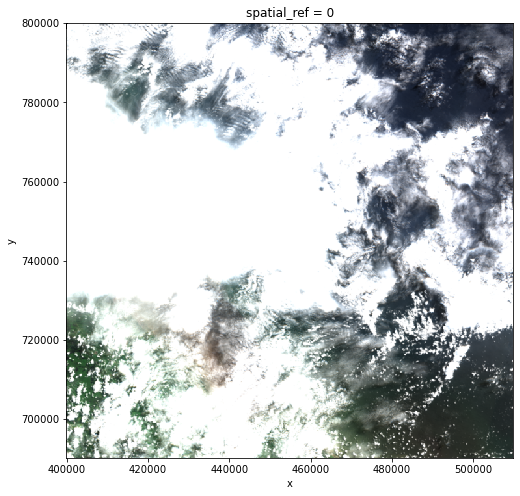

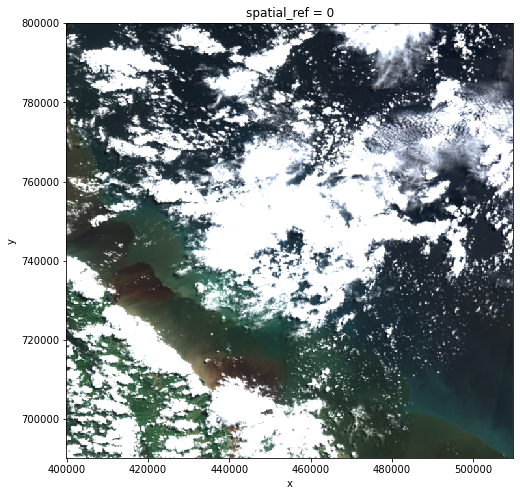

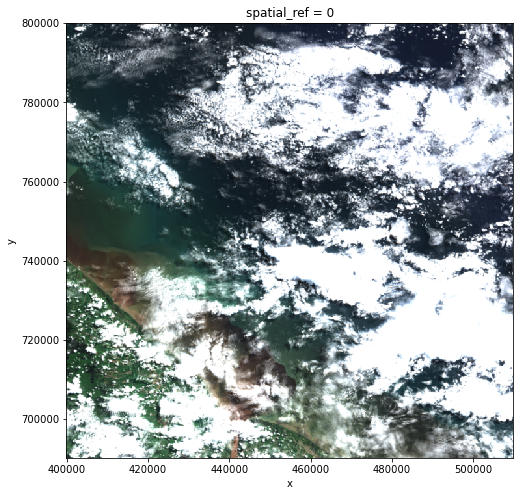

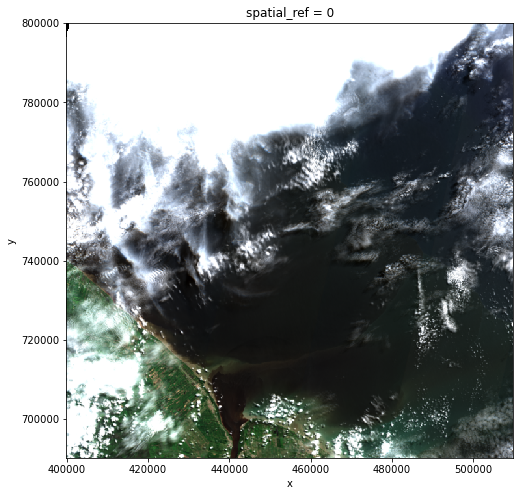

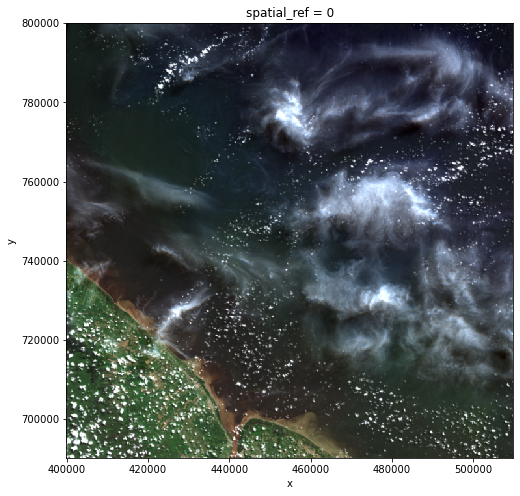

...

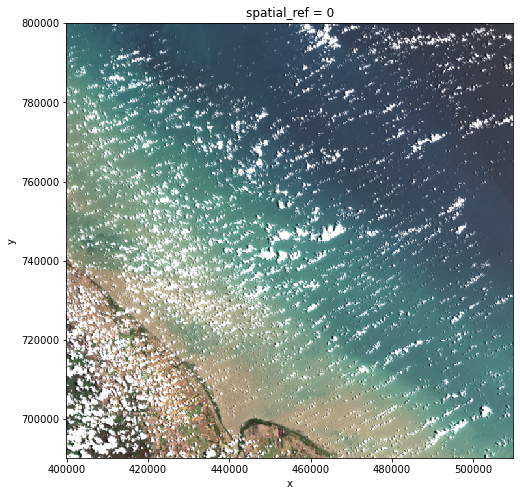

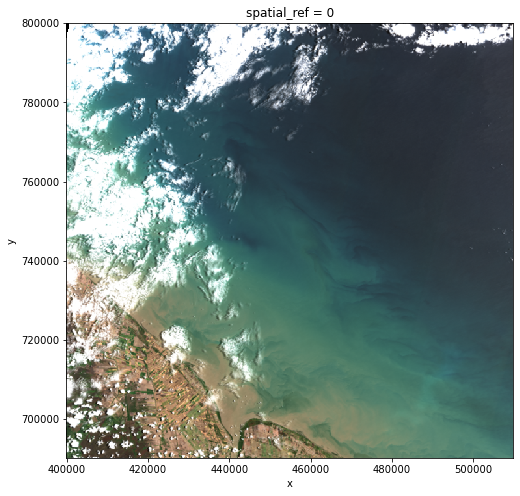

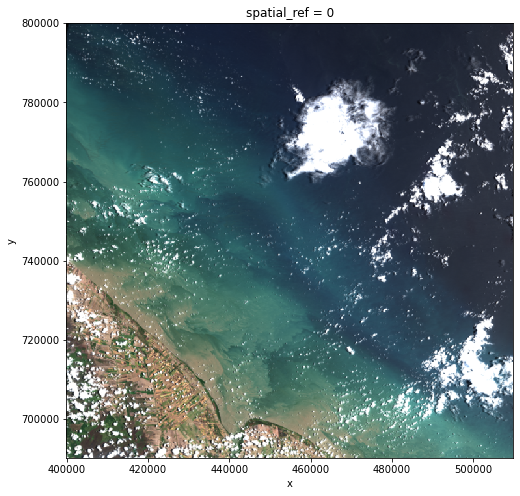

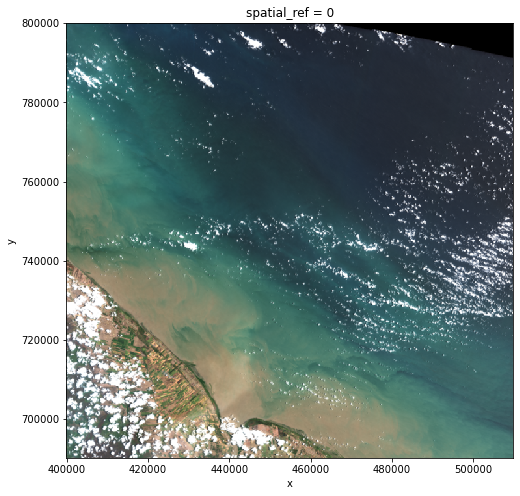

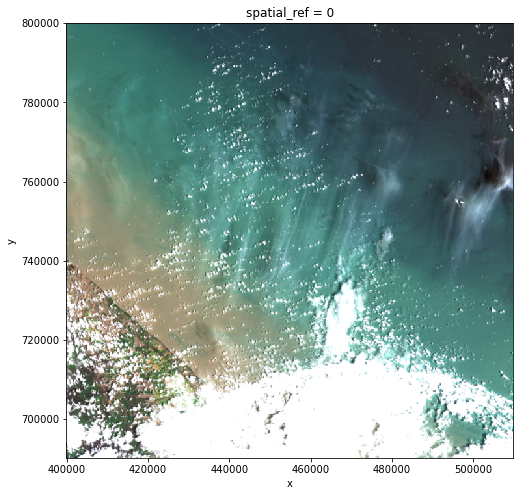

KeyboardInterrupt: 

In [64]:
for item in items:
    raster_overview = rioxarray.open_rasterio(item.assets["visual"].href, overview_level=3)
    raster_overview.plot.imshow(figsize=(8, 8))
    plt.show()


In [22]:
CRS(raster.rio.crs)

<Derived Projected CRS: EPSG:32621>
Name: WGS 84 / UTM zone 21N
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: UTM zone 21N
- method: Transverse Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [23]:
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [24]:
gdf = gdf.to_crs(raster.rio.crs)

In [25]:
gdf

,id,geometry
0,None,"MULTIPOLYGON (((414532.764 718014.110, 415084...."


In [26]:
raster_clip_box = raster.rio.clip_box(*gdf.total_bounds)
print(raster_clip_box.shape)

(3, 42, 58)


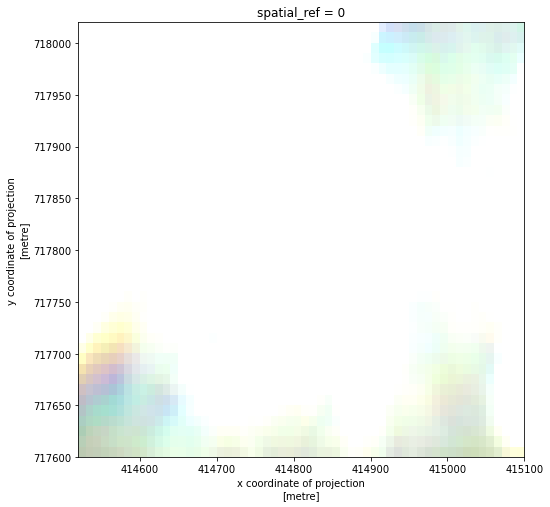

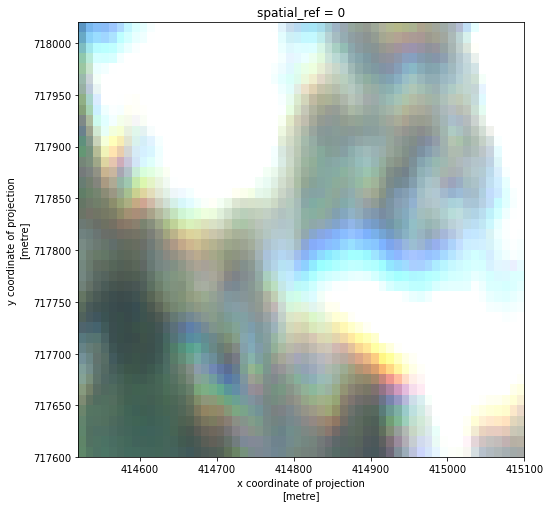

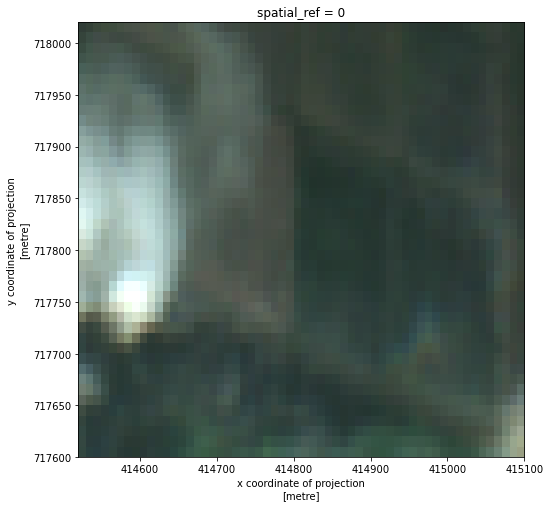

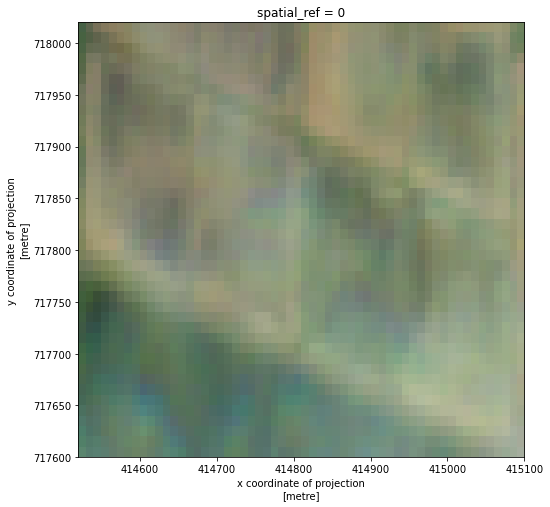

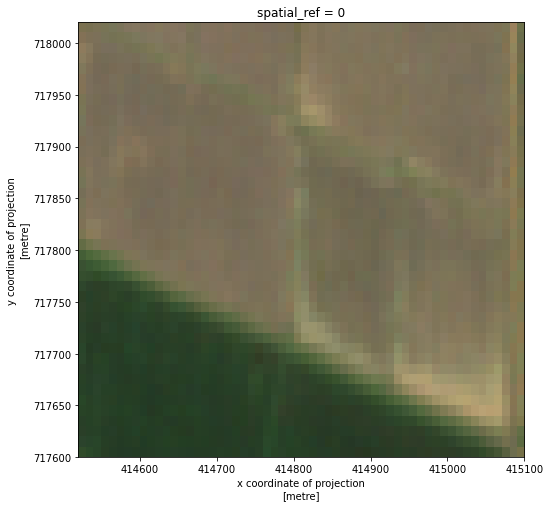

...

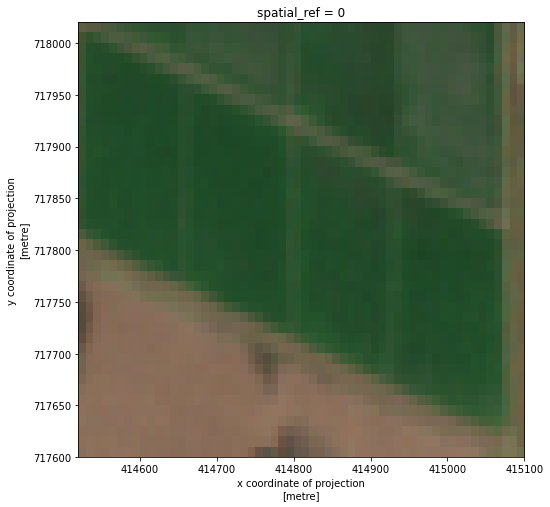

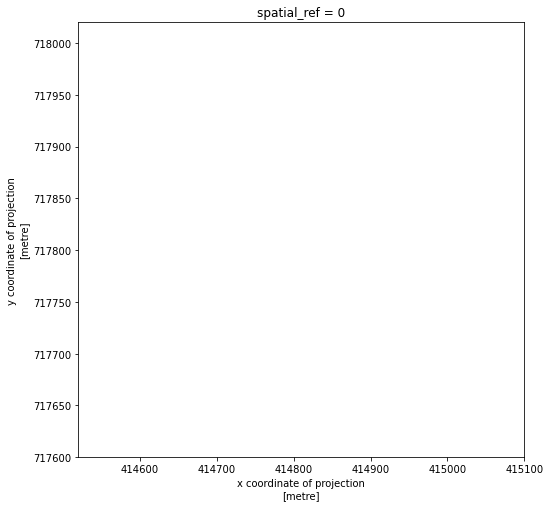

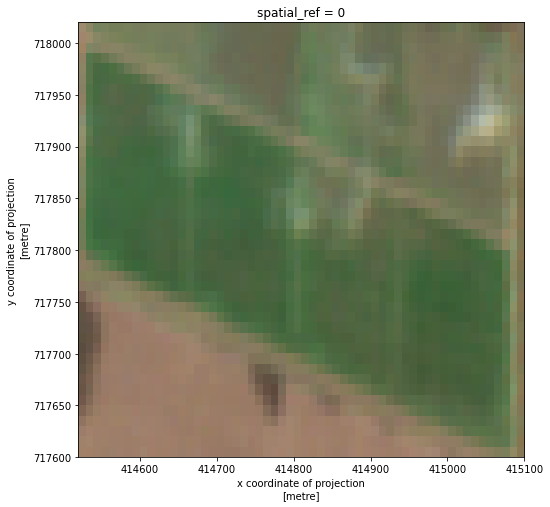

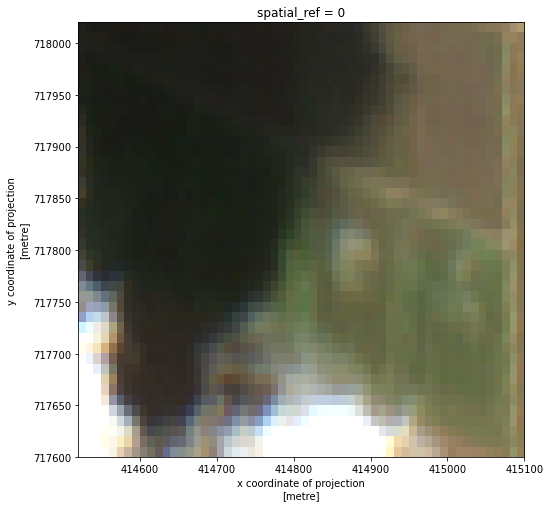

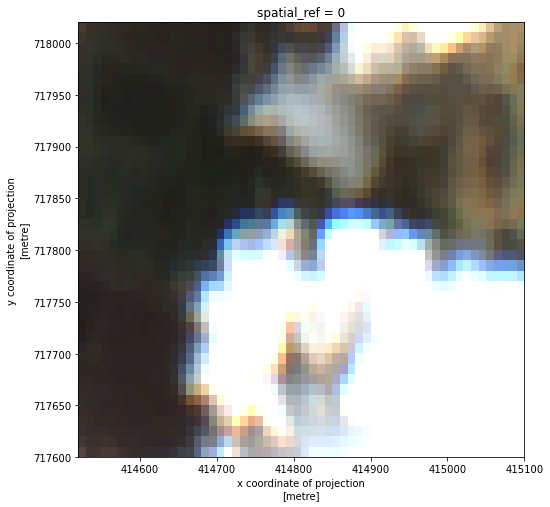

In [72]:
for item in items:
    raster = rioxarray.open_rasterio(item.assets["visual"].href)
    raster_clip_box = raster.rio.clip_box(*gdf.total_bounds)
    raster_clip_box.plot.imshow(figsize=(8, 8))
    plt.show()  
    plt.close()  
    raster.close()


In [75]:
raster_clip_box

<xarray.DataArray (band: 3, y: 42, x: 58)>
[7308 values with dtype=uint8]
Coordinates:
  * band         (band) int64 1 2 3
  * x            (x) float64 4.145e+05 4.145e+05 ... 4.151e+05 4.151e+05
  * y            (y) float64 7.18e+05 7.18e+05 7.18e+05 ... 7.176e+05 7.176e+05
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:       Area
    OVR_RESAMPLING_ALG:  AVERAGE
    scale_factor:        1.0
    add_offset:          0.0
    _FillValue:          0

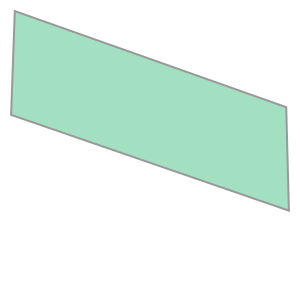

In [27]:
gdf.geometry[0]

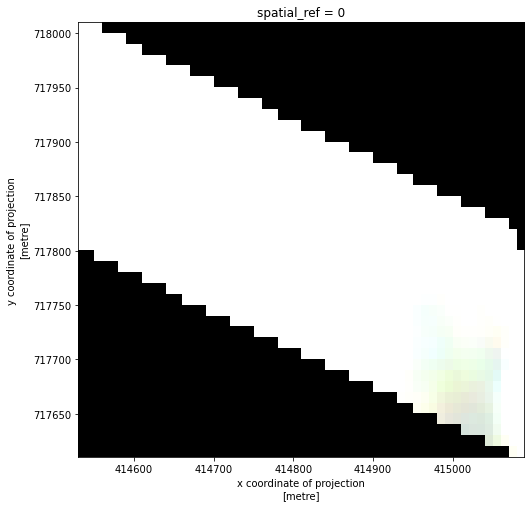

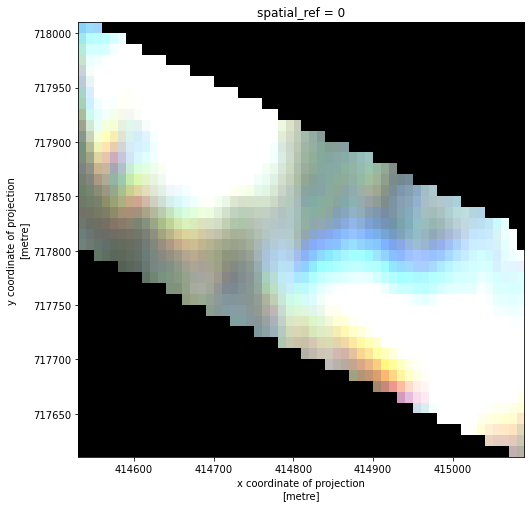

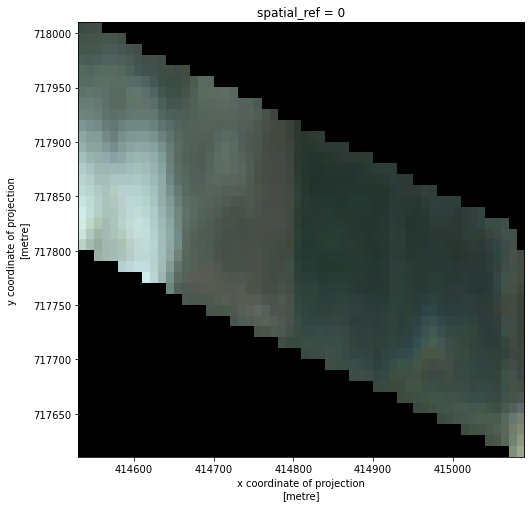

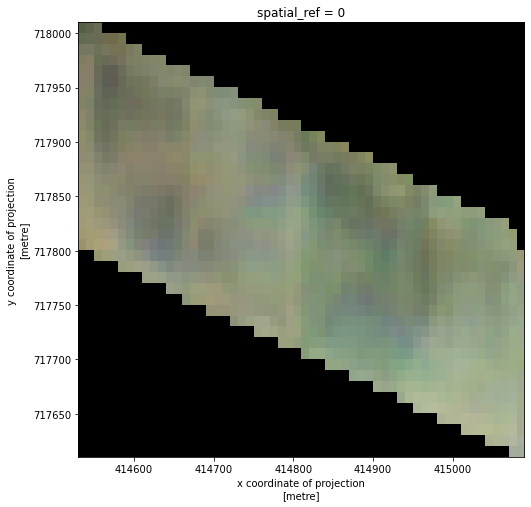

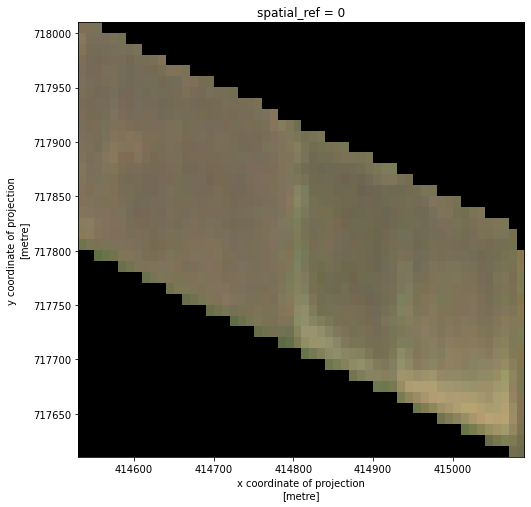

...

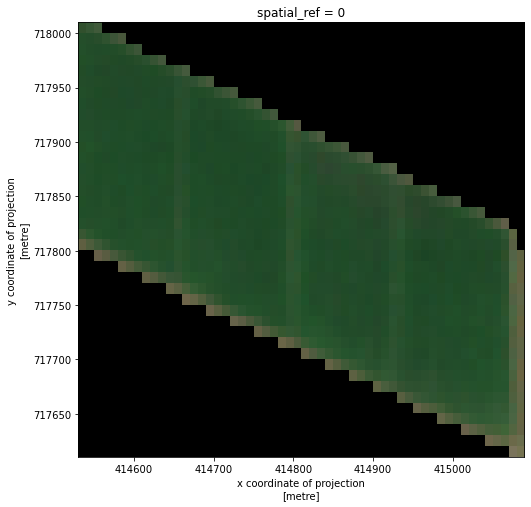

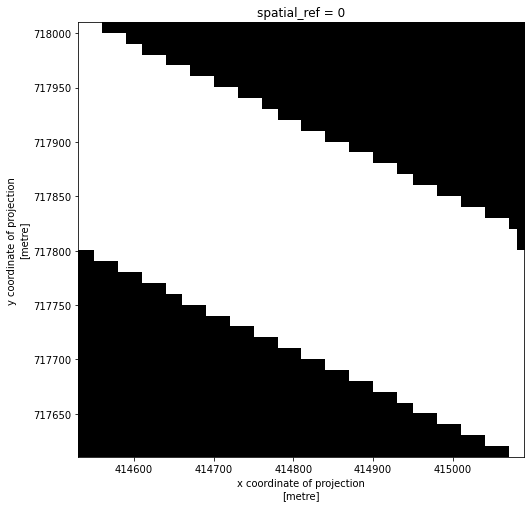

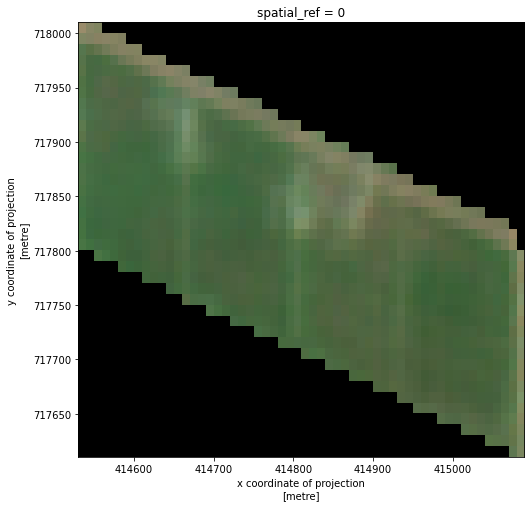

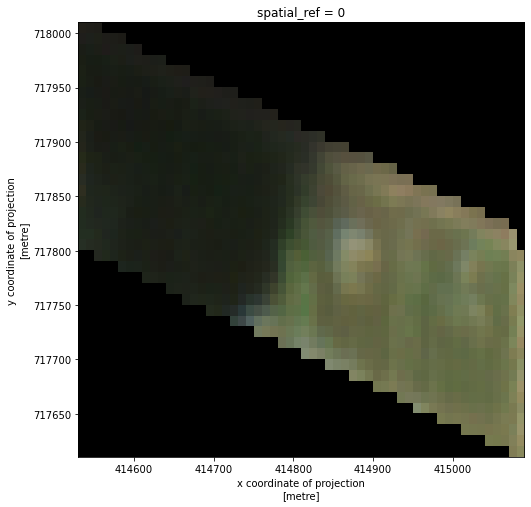

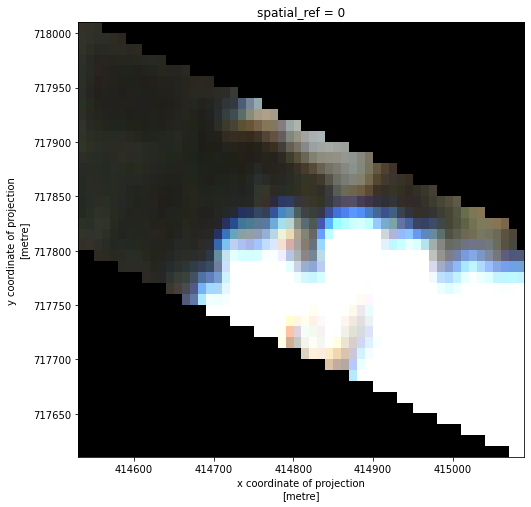

In [28]:
for item in items:
    raster = rioxarray.open_rasterio(item.assets["visual"].href)
    raster_clip_box = raster.rio.clip_box(*gdf.total_bounds)
    raster_clip_fields = raster_clip_box.rio.clip(gdf['geometry'])
    fig, ax = plt.subplots(figsize=(8, 8))
    raster_clip_fields.plot.imshow(ax=ax)  
    plt.show()  

In [29]:
SWIR_uri = items[1].assets["swir16"].href
nir_uri = items[1].assets["nir08"].href

In [30]:
SWIR_uri

'https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/21/N/VH/2024/7/S2A_21NVH_20240725_0_L2A/B11.tif'

In [31]:
red = rioxarray.open_rasterio(SWIR_uri, masked=True)
nir = rioxarray.open_rasterio(nir_uri, masked=True)

In [32]:
red

<xarray.DataArray (band: 1, y: 5490, x: 5490)>
[30140100 values with dtype=float32]
Coordinates:
  * band         (band) int64 1
  * x            (x) float64 4e+05 4e+05 4e+05 ... 5.097e+05 5.097e+05 5.098e+05
  * y            (y) float64 8e+05 8e+05 8e+05 ... 6.903e+05 6.903e+05 6.902e+05
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:       Area
    OVR_RESAMPLING_ALG:  AVERAGE
    scale_factor:        1.0
    add_offset:          0.0

In [50]:
red_clip = red.rio.clip(gdf['geometry'])

In [52]:
nir_clip = nir.rio.clip(gdf['geometry'])

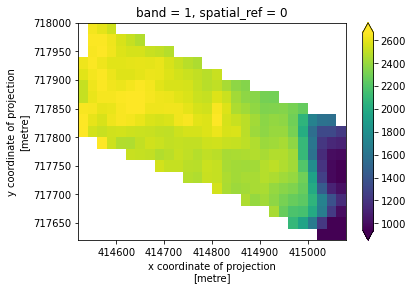

In [51]:
red_clip.plot(robust=True)

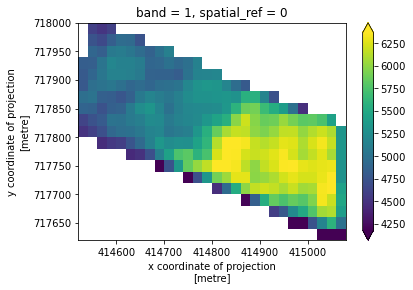

In [53]:
nir_clip.plot(robust=True)

In [54]:
red_clip_matched = red_clip.rio.reproject_match(nir_clip)
print(red_clip_matched.shape)

(1, 19, 28)


In [55]:
ndmi = (nir_clip - red_clip_matched)/ (nir_clip + red_clip_matched)
print(ndmi)

<xarray.DataArray (band: 1, y: 19, x: 28)>
array([[[       nan, 0.27049068, 0.2697609 , 0.28885776,        nan,
                nan,        nan,        nan,        nan,        nan,
                nan,        nan,        nan,        nan,        nan,
                nan,        nan,        nan,        nan,        nan,
                nan,        nan,        nan,        nan,        nan,
                nan,        nan,        nan],
        [       nan, 0.28121194, 0.27464116, 0.29527137, 0.3177035 ,
         0.3236559 , 0.31520534,        nan,        nan,        nan,
                nan,        nan,        nan,        nan,        nan,
                nan,        nan,        nan,        nan,        nan,
                nan,        nan,        nan,        nan,        nan,
                nan,        nan,        nan],
        [       nan, 0.2975843 , 0.29009876, 0.31695905, 0.3282861 ,
         0.326657  , 0.3186608 , 0.3161675 , 0.33128998, 0.34868422,
                nan,        nan,     

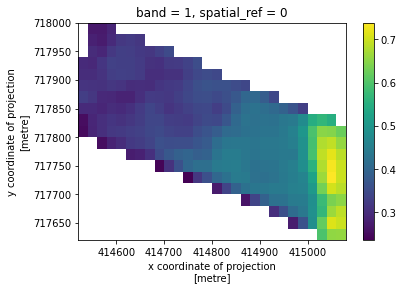

In [56]:
ndmi.plot()

ValueError: A 3-dimensional array was passed to imshow(), but there is no dimension that could be color.  At least one dimension must be of size 3 (RGB) or 4 (RGBA), and not given as x or y.

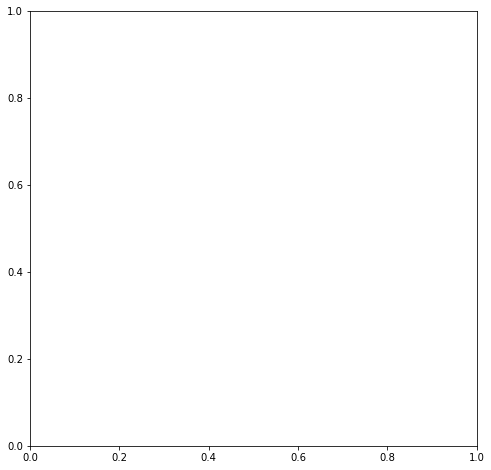

In [59]:
for item in items:
    SWIR_uri = item.assets["swir16"].href
    nir_uri = item.assets["nir08"].href
    red = rioxarray.open_rasterio(SWIR_uri, masked=True)
    nir = rioxarray.open_rasterio(nir_uri, masked=True)  
    red_clip = red.rio.clip(gdf['geometry'])
    nir_clip = nir.rio.clip(gdf['geometry'])
    red_clip_matched = red_clip.rio.reproject_match(nir_clip)
    ndmi = (nir_clip - red_clip_matched)/ (nir_clip + red_clip_matched)
    fig, ax = plt.subplots(figsize=(8, 8))
    ndmi.plot.imshow(ax=ax)
    plt.show()


RuntimeError: No mappable was found to use for colorbar creation. First define a mappable such as an image (with imshow) or a contour set (with contourf).

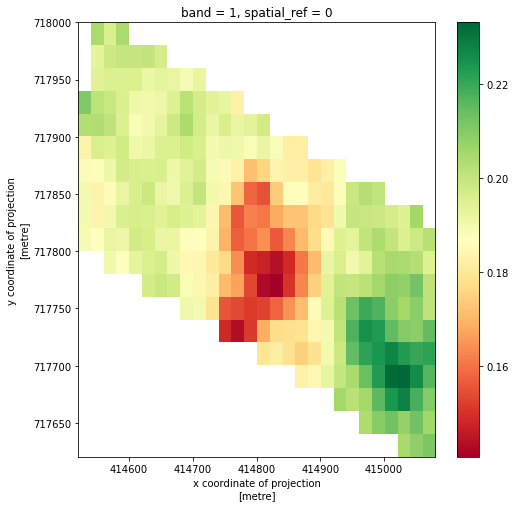

In [63]:

for item in items:
    try:
      
        if "swir16" not in item.assets or "nir08" not in item.assets:
            print(f"Warning: Skipping item {item.id} due to missing assets.")
            continue


        SWIR_uri = item.assets["swir16"].href
        nir_uri = item.assets["nir08"].href
        red = rioxarray.open_rasterio(SWIR_uri, masked=True)
        nir = rioxarray.open_rasterio(nir_uri, masked=True)

        red_clip = red.rio.clip(gdf['geometry'], gdf.crs)
        nir_clip = nir.rio.clip(gdf['geometry'], gdf.crs)

        if red_clip.rio.crs != nir_clip.rio.crs:
            red_clip_matched = red_clip.rio.reproject_match(nir_clip)
        else:
            red_clip_matched = red_clip

        ndmi = (nir_clip - red_clip_matched) / (nir_clip + red_clip_matched)

        if ndmi.rio.count == 1:
            ndmi = ndmi.squeeze()

   
        fig, ax = plt.subplots(figsize=(8, 8))
        ndmi.plot.imshow(ax=ax, cmap='RdYlGn')
        plt.colorbar(ax=ax, label='NDMI')
        plt.title(f'NDMI for item {item.id}')
        plt.show()

    except (FileNotFoundError, ValueError) as e:
        print(f"Error processing item {item.id}: {e}")

    finally:
      
        red.close()
        nir.close()


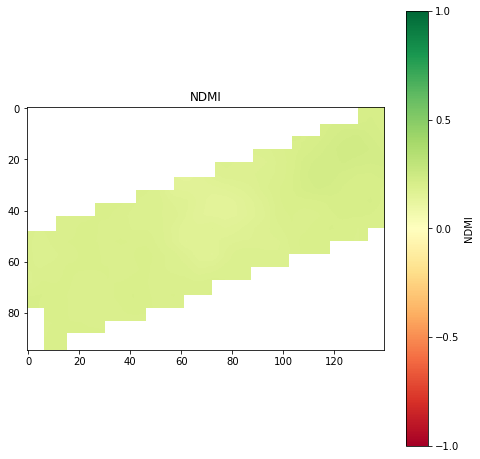

KeyboardInterrupt: 

In [70]:
for item in items:
    SWIR_uri = item.assets["swir16"].href
    nir_uri = item.assets["nir08"].href
    red = rioxarray.open_rasterio(SWIR_uri, masked=True)
    nir = rioxarray.open_rasterio(nir_uri, masked=True)

    red_clip = red.rio.clip(gdf['geometry'], gdf.crs)
    nir_clip = nir.rio.clip(gdf['geometry'], gdf.crs)

    if red_clip.rio.crs != nir_clip.rio.crs:
        red_clip_matched = red_clip.rio.reproject_match(nir_clip)
    else:
        red_clip_matched = red_clip

    ndmi = (nir_clip - red_clip_matched) / (nir_clip + red_clip_matched)

    if ndmi.rio.count == 1:
        ndmi = ndmi.squeeze()

    ndmi_resampled = ndmi.interp(
        x=np.linspace(ndmi.x.min(), ndmi.x.max(), ndmi.shape[1] * 5),
        y=np.linspace(ndmi.y.min(), ndmi.y.max(), ndmi.shape[0] * 5),
        method="linear"
    )


    fig, ax = plt.subplots(figsize=(8, 8))
    im = ax.imshow(ndmi_resampled, cmap='RdYlGn', vmin=-1, vmax=1)
    cbar = plt.colorbar(im, ax=ax, label='NDMI')
    cbar.set_ticks([-1, -0.5, 0, 0.5, 1])
    plt.title(f'NDMI')
    plt.show()


    red.close()
    nir.close()